In [70]:
!pip install xlrd
!pip install ydata-profiling
!pip install scikeras
!pip install sklearn-pandas
!pip install imbalanced-learn
!pip install ipywidgets

In [2]:
import pandas as pd
from ydata_profiling import ProfileReport

from sklearn.model_selection import train_test_split

# for deep learning:
import tensorflow as tf
import numpy as np

from tensorflow import keras
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Conv2D, Dropout
from tensorflow.keras.layers import BatchNormalization, Flatten
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Reshape 
from tensorflow.keras.optimizers import RMSprop 
from sklearn.preprocessing import LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder

# for plotting:
import pandas as pd
from matplotlib import pyplot as plt
%matplotlib inline

### Ingeniería de datos

In [3]:
# Carga del archivo CSV en un df
import csv

file_path = "Dataset_Proyecto3_ACTD.csv"
df = pd.read_csv(file_path, header=0)

# Mostrar las primeras filas del DataFrame para asegurarse de que se haya cargado correctamente
print(df.head())


   periodo estu_tipodocumento  estu_consecutivo cole_area_ubicacion  \
0    20224                 TI  SB11202240068406              URBANO   
1    20224                 TI  SB11202240363282               RURAL   
2    20224                 TI  SB11202240285537              URBANO   
3    20224                 TI  SB11202240096028              URBANO   
4    20224                 TI  SB11202240066279              URBANO   

  cole_bilingue cole_calendario      cole_caracter  \
0             N               A  TÉCNICO/ACADÉMICO   
1             N               A            TÉCNICO   
2             N               A          ACADÉMICO   
3             N               A          ACADÉMICO   
4             N               A          ACADÉMICO   

   cole_cod_dane_establecimiento  cole_cod_dane_sede  \
0                   1.520010e+11        152001000785   
1                   2.520510e+11        252051000691   
2                   1.523560e+11        152356000182   
3                   3.52

Por medio de los resultados del perfilamiento de datos es posible apreciar que hay 440066 datos faltantes, representado un 3,9% del dataset e inclusive hay entradas repetidas. Respecto a los outliers o datos anomalos se evidenciaron valores superiores a un puntaje de 100 para las pruebas de ingles y matematicas, valores fuera del rango de las pruebas icfes (68 instancias entre ambas variables). Adicionalemente, se identifico que para la variable calendario se se presentaron 119 entradas de 'otro' donde los posibles calendarios en Colombia son 'A' y 'B'. De igual manera sucedio con los tipos de documentos PC, PV y V, que contaban con 8, 5 y 4 instancias, respectivamente y no se encuentran definidos en los tipos de documentos utilizados en Colombia. Por esta razón, estas instancias fueron eliminadas del dataset, es considerando que representaban un pequeño porcentaje del mismo. 

Por otro lado, se evidencia una baja correlación entre las diferentes variables con la variable de puntaje global (nuestra variable de interés para dar respuesta a las preguntas), exceptuando a las variables directamente relacionadas como puntajes de las diferentes áreas del conocimiento incluidas en la prueba (ingles, ciencias, etc). A partir de esto, se decidio remover distintas variables para el entrenamiento y obtención de la predicción, esto por medio de la determinación de si una variable es redundante, su correlación es muy baja, casi la totalidad o casi la totalidad de los datos se encuentran en una misma categoria o valor o hacian referencia a un identificador. Así mismo, Es posible apreciar que algunos datos cuentan con escalas variadas incluyendo grandes diferencias entre ordenes de magnitud, dado la naturaleza númerica o categorica de algunas variables. Debido a esto, es una buena practica realizar un proceso de normalización de los datos para mejorar el proceso de entrenamiento y evitar que valores con mangitudes considerablemente grandes afecten dicho proceso y por consiguiente los resultados. Por otra parte, el perfilamiento permitio identificar valores que podían influir sobre el entrenamiento los cuales serán eliminados o recategorizados.

Se le realiza la división de los conjutos de prueba, entrenamiento y validación, utilizando la semilla 42 y un 20% para el conjunto de test, el conjunto de entrenamiento es nuevamente divido para obtener el conjunto de validación.

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

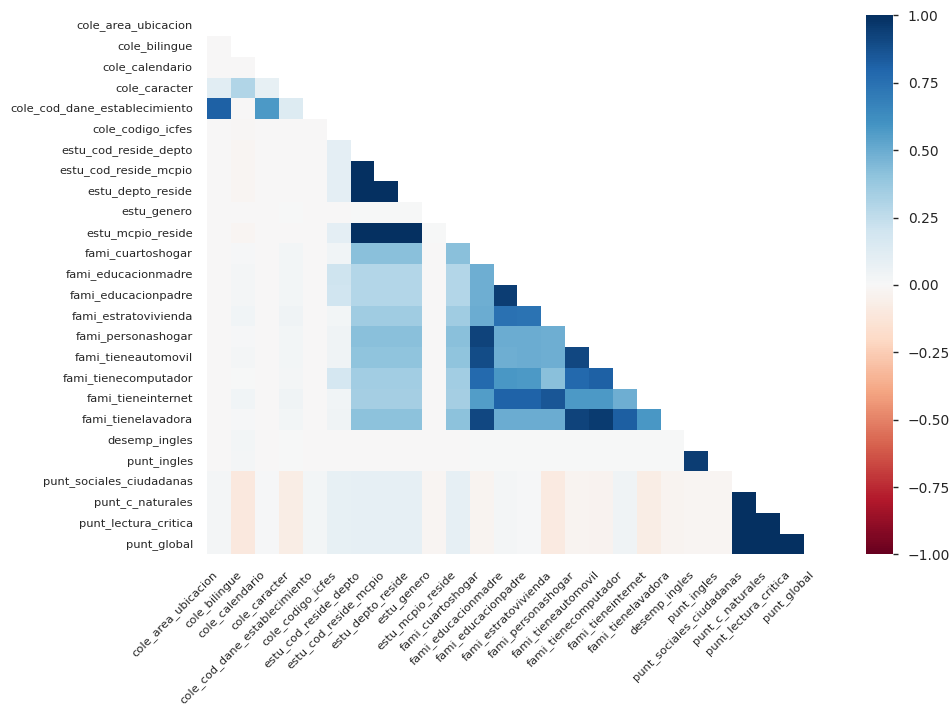

In [4]:
ProfileReport(df)

Se removieron las variables redundantes, que solo contaban con un valor o que las entradas unicamente representaban un identificador para el estudiante, institución, municipio o departamento.

In [99]:
df = df.drop(columns=['periodo', 'estu_consecutivo', 'cole_cod_dane_establecimiento', 'cole_cod_dane_sede', 
                      'cole_cod_depto_ubicacion', 'cole_cod_mcpio_ubicacion', 'cole_codigo_icfes', 'cole_depto_ubicacion',
                      'cole_nombre_establecimiento', 'cole_nombre_sede', 'estu_cod_depto_presentacion', 'estu_cod_mcpio_presentacion',
                      'estu_cod_reside_depto', 'estu_cod_reside_mcpio','estu_depto_presentacion', 'estu_estudiante', 
                      'estu_fechanacimiento', 'estu_pais_reside', 'estu_depto_reside', 'estu_privado_libertad', 'cole_mcpio_ubicacion',
                      'cole_genero', 'estu_nacionalidad', 'estu_mcpio_reside', 'cole_sede_principal', 'fami_cuartoshogar', 
                      'fami_personashogar', 'fami_educacionmadre', 'fami_educacionpadre', 'estu_estadoinvestigacion', 'cole_naturaleza'
                      ])

In [100]:
df.columns

Index(['estu_tipodocumento', 'cole_area_ubicacion', 'cole_bilingue',
       'cole_calendario', 'cole_caracter', 'cole_jornada', 'estu_genero',
       'estu_mcpio_presentacion', 'fami_estratovivienda',
       'fami_tieneautomovil', 'fami_tienecomputador', 'fami_tieneinternet',
       'fami_tienelavadora', 'desemp_ingles', 'punt_ingles',
       'punt_matematicas', 'punt_sociales_ciudadanas', 'punt_c_naturales',
       'punt_lectura_critica', 'punt_global'],
      dtype='object')

In [101]:
# Obtener el conteo de cada clase en la columna 'x'
conteo_clases = df['estu_tipodocumento'].value_counts()

# Mostrar el conteo de clases
print(conteo_clases)

estu_tipodocumento
TI     162003
CC      55354
CR       4557
CE        202
NES        46
PEP        16
PC          8
PE          6
PV          5
V           4
RC          4
Name: count, dtype: int64


Se realizo una limpieza de las variables con datos anomalos, outliers o que no correspondian con los datos, así como las filas duplicadas. Como se observo en el perfilamiento de los datos.

In [102]:
df.columns

Index(['estu_tipodocumento', 'cole_area_ubicacion', 'cole_bilingue',
       'cole_calendario', 'cole_caracter', 'cole_jornada', 'estu_genero',
       'estu_mcpio_presentacion', 'fami_estratovivienda',
       'fami_tieneautomovil', 'fami_tienecomputador', 'fami_tieneinternet',
       'fami_tienelavadora', 'desemp_ingles', 'punt_ingles',
       'punt_matematicas', 'punt_sociales_ciudadanas', 'punt_c_naturales',
       'punt_lectura_critica', 'punt_global'],
      dtype='object')

In [104]:
"""# Definir el diccionario de mapeo
d_cuartos = {
    'Tres': 'Tres',
    'Dos': 'Dos',
    'Cuatro': 'Cuatro',
    'Uno': 'Uno',
    'Cinco': 'Cinco',
    'Seis o mas': '6 o más',
    'Seis': '6 o más',
    'Siete': '6 o más',
    'Ocho': '6 o más',
    'Diez o más': '6 o más',
    'Nueve': '6 o más'
}

# Definir el diccionario de mapeo
d_personas = {
    '3 a 4': '3 a 4',
    'Cuatro': '3 a 4',
    'Cinco': '5 a 6',
    '5 a 6': '5 a 6',
    'Tres': '3 a 4',
    'Seis': '5 a 6',
    'Siete': '7 a 8',
    '7 a 8': '7 a 8',
    '1 a 2': '1 a 2',
    'Ocho': '7 a 8',
    'Dos': '1 a 2',
    '9 o más': '9 o más',
    'Nueve': '9 o más',
    'Diez': '9 o más',
    'Doce o más': '9 o más',
    'Once': '9 o más',
    'Una': '1 a 2'
}


df['fami_cuartoshogar'] = df['fami_cuartoshogar'].replace(d_cuartos)
df['fami_personashogar'] = df['fami_personashogar'].replace(d_cuartos)"""

df = df[df['punt_matematicas'] <= 100]
df = df[df['punt_ingles'] <= 100]
df = df[df['cole_calendario'] != 'OTRO']
df = df[~df['estu_tipodocumento'].isin(['PC', 'PV', 'V'])]
df = df.drop_duplicates()

Separación entre el set de entrenamiento, prueba y validación. En esta ocasión se adopto un 25% de los datos del dataset para prueba y un 30% de los datos de entrenamiento para validación del modelo.

In [105]:
train, test = train_test_split(df, test_size=0.25, random_state=42)

In [106]:
x_train = train.drop(columns=['punt_global'])
y_train = train['punt_global']
x_test = test.drop(columns=['punt_global'])
y_test = test['punt_global']

Imputación de datos, normalización y label encoding a los datos categoricos (a los datos de entrenamiento antes de hacer la partición entre entrenamiento y validación).

In [108]:
# Selecciona las columnas numéricas y categóricas
numeric_features = ['punt_ingles',
                    'punt_matematicas', 'punt_sociales_ciudadanas', 'punt_c_naturales',
                    'punt_lectura_critica']
categorical_features = ['estu_tipodocumento', 'cole_area_ubicacion', 'cole_bilingue',
                        'cole_calendario', 'cole_caracter', 'cole_jornada', 'estu_genero',
                        'estu_mcpio_presentacion', 'fami_estratovivienda',
                        'fami_tieneautomovil', 'fami_tienecomputador', 'fami_tieneinternet',
                        'fami_tienelavadora', 'desemp_ingles']

for cat in categorical_features:
    le = LabelEncoder()
    x_train[cat] = le.fit_transform(train[cat])
    x_test[cat] = le.fit_transform(test[cat])

In [109]:
# Pipeline para los datos numéricos
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', StandardScaler())
])

# Pipeline para los datos categóricos
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent'))
])
other_transformer = 'passthrough'

# Combinamos ambos pipelines en un column transformer
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Aplicamos la transformación
preprocessed_train = preprocessor.fit_transform(x_train)
preprocessed_test = preprocessor.fit_transform(x_test)


# Creamos un DataFrame a partir del array transformado y los nombres de las columnas
x_train = pd.DataFrame(preprocessed_train, columns=numeric_features+categorical_features)
x_test = pd.DataFrame(preprocessed_test, columns=numeric_features+categorical_features)

In [110]:
x_train.head()

,punt_ingles,punt_matematicas,punt_sociales_ciudadanas,punt_c_naturales,punt_lectura_critica,estu_tipodocumento,cole_area_ubicacion,cole_bilingue,cole_calendario,cole_caracter,cole_jornada,estu_genero,estu_mcpio_presentacion,fami_estratovivienda,fami_tieneautomovil,fami_tienecomputador,fami_tieneinternet,fami_tienelavadora,desemp_ingles
0,-0.534382,-0.110905,2.259532e-01,0.721078,-3.163360e-02,7.0,0.0,2.0,0.0,0.0,1.0,1.0,12.0,0.0,0.0,1.0,1.0,1.0,0.0
1,-1.196151,-0.605326,7.862633e-16,0.000000,-8.759589e-16,0.0,1.0,0.0,0.0,0.0,3.0,1.0,17.0,7.0,2.0,2.0,2.0,2.0,0.0
2,0.127387,0.383517,8.898935e-01,0.012824,1.077889e+00,0.0,1.0,0.0,0.0,0.0,2.0,1.0,17.0,0.0,0.0,0.0,0.0,0.0,1.0
3,-0.439844,-0.852537,7.862633e-16,0.000000,-8.759589e-16,2.0,1.0,0.0,0.0,3.0,1.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0,1.0
4,-0.250767,-0.934940,-8.806140e-01,-2.111937,-5.247546e-01,7.0,1.0,0.0,0.0,3.0,1.0,0.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0


In [111]:
x_test.head()

,punt_ingles,punt_matematicas,punt_sociales_ciudadanas,punt_c_naturales,punt_lectura_critica,estu_tipodocumento,cole_area_ubicacion,cole_bilingue,cole_calendario,cole_caracter,cole_jornada,estu_genero,estu_mcpio_presentacion,fami_estratovivienda,fami_tieneautomovil,fami_tienecomputador,fami_tieneinternet,fami_tienelavadora,desemp_ingles
0,-1.195121,-0.693406,0.000000,0.000000,-1.747794e-15,0.0,0.0,0.0,0.0,2.0,1.0,1.0,21.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.122125,-0.445735,-1.431244,-1.397579,-1.540148e-01,6.0,1.0,0.0,0.0,0.0,1.0,0.0,17.0,3.0,1.0,1.0,1.0,0.0,1.0
2,-1.289210,-0.528292,-0.329889,-0.456239,1.444856e+00,0.0,0.0,0.0,0.0,2.0,3.0,1.0,22.0,7.0,0.0,0.0,2.0,0.0,0.0
3,2.097994,1.618182,0.000000,0.000000,-1.747794e-15,6.0,1.0,0.0,1.0,0.0,0.0,0.0,17.0,4.0,1.0,1.0,1.0,1.0,4.0
4,-0.348320,-0.610849,-1.871786,-1.632914,-1.875876e+00,6.0,0.0,0.0,0.0,3.0,1.0,1.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0


Imputación a los puntajes globales

In [112]:
y_mean = y_train.mean()

# Convertir la Serie 'y_train' a DataFrame
y_train = y_train.to_frame()

# Convertir la Serie 'y_test' a DataFrame
y_test = y_test.to_frame()

# Imputar valores faltantes con la media
y_train.fillna(y_mean, inplace=True)
y_test.fillna(y_mean, inplace=True)

# Cambiar el nombre de la columna a 'punt_global' en y_train
y_train.rename(columns={y_train.columns[0]: 'punt_global'}, inplace=True)

# Cambiar el nombre de la columna a 'punt_global' en y_test
y_test.rename(columns={y_test.columns[0]: 'punt_global'}, inplace=True)


Se definen los grupos de clasificación de los estudiantes de acuerdo con su puntaje global:

- Malo: [100, 300)
- Aceptable: [200, 300)
- Bueno: [300, 500]


In [113]:
# Definir los límites y las etiquetas de las categorías
bins = [0, 200, 300, 500]
labels = ['Malo', 'Aceptable', 'Bueno']

# Crear la nueva columna basada en los rangos de 'punt_global'
y_train['categoria'] = pd.cut(y_train['punt_global'], bins=bins, labels=labels, right=False)
y_test['categoria'] = pd.cut(y_test['punt_global'], bins=bins, labels=labels, right=False)

le = LabelEncoder()
y_train['categoria_encoded'] = le.fit_transform(y_train['categoria'])
y_test['categoria_encoded'] = le.fit_transform(y_test['categoria'])

In [174]:
# Imprimir las clases únicas y sus correspondientes valores asignados por el Label Encoder
print("Clases únicas:", le.classes_)
print("Valores asignados a las clases únicas:", le.transform(le.classes_))

Clases únicas: ['Aceptable' 'Bueno' 'Malo']
Valores asignados a las clases únicas: [0 1 2]


Se verifica que las clases esten balanceadas, donde es posible apreciar inicialmente un claro desbalance de clases. Esto tambien es posible evidenciarlo en el distribución del puntaje global donde se asemeja a una distribución normal con media en 250,66 y desviación estandar de 50,84 indicando que la mayoría de los datos se encuentran concentrados en el rango de aceptable: [200, 300). Por esta razon se probarán dos alternativas para el balanceo de datos: oversampling y undersampling.

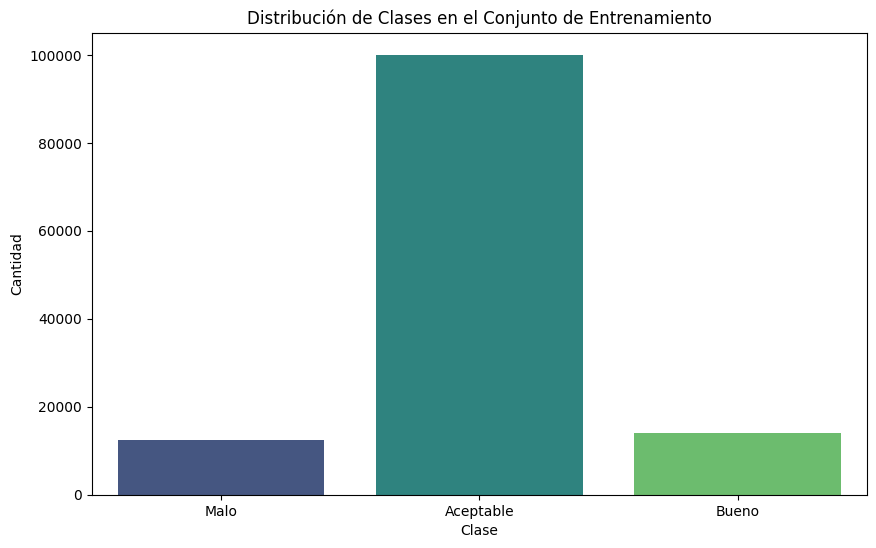

In [114]:
 import matplotlib.pyplot as plt
 import seaborn as sns

 # Contar la cantidad de cada clase en y_train
 class_counts = y_train['categoria'].value_counts()

 # Graficar el desbalance de clases
 plt.figure(figsize=(10, 6))
 sns.barplot(x=class_counts.index, y=class_counts.values, palette='viridis')
 plt.title('Distribución de Clases en el Conjunto de Entrenamiento')
 plt.xlabel('Clase')
 plt.ylabel('Cantidad')
 plt.show()

Acomodar los set 'y' para que unicamente tenga las clases posteriores al label encoder

In [115]:
y_train = y_train.drop(columns=['punt_global', 'categoria'])
y_test = y_test.drop(columns=['punt_global', 'categoria'])

### Oversampling

Se realiza el proceso de oversampling utilizando la libreria SMOTE

In [116]:
from imblearn.over_sampling import SMOTE

# Aplicar SMOTE para sobremuestreo
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(x_train, y_train)

Se imprimen las clases y es posible evidenciar que utilizando smote se llega a un balance de clases con 100000 datos para cada clase

In [117]:
y_train_smote_series = pd.Series(y_train_smote['categoria_encoded'])
print(y_train_smote_series.value_counts())

categoria_encoded
0    100057
1    100057
2    100057
Name: count, dtype: int64


### Undersampling

Se realiza un proceso de undersampling paralelamente para evaluar ambas alternativas y conservar la que mejor rendimiento del modelo permita

In [118]:
from imblearn.under_sampling import RandomUnderSampler

# Crear una instancia de RandomUnderSampler
rus = RandomUnderSampler(random_state=42)

# Aplicar undersampling a los datos de entrenamiento
X_train_under, y_train_under = rus.fit_resample(x_train, y_train)


Se imprime la distribución de clases conseguida con el undersampling, donde se observa que el numero de instancias por clase esta al rededor de las 12000

In [119]:
# Convertir la columna 'punt_global' de y_train_under a Serie antes de imprimir la distribución de clases
y_train_under_series = pd.Series(y_train_under['categoria_encoded'])
print(y_train_under_series.value_counts())


categoria_encoded
0    12371
1    12371
2    12371
Name: count, dtype: int64


Una vez hecho el preprocesamiento se procede a realizar la partición del set de validación, donde se deja un 30% de los datos para la validación del modelo

In [120]:
X_over_train, X_over_val, y_over_train, y_over_val = train_test_split(X_train_smote, y_train_smote, test_size=0.2, random_state=42)
X_under_train, X_under_val, y_under_train, y_under_val = train_test_split(X_train_under, y_train_under, test_size=0.2, random_state=42)

In [121]:
print(X_over_train.shape)
print(X_over_val.shape)
print(X_under_train.shape)
print(X_under_val.shape)

(240136, 19)
(60035, 19)
(29690, 19)
(7423, 19)


In [122]:
class_counts_over = y_over_train.value_counts()
print(class_counts_over)
class_counts_under = y_under_train.value_counts()
print(class_counts_under)

categoria_encoded
2                    80178
0                    80007
1                    79951
Name: count, dtype: int64
categoria_encoded
2                    9972
0                    9859
1                    9859
Name: count, dtype: int64


In [124]:
import random

# Fijar las semillas aleatorias para reproducibilidad
seed_value = 42
np.random.seed(seed_value)
tf.random.set_seed(seed_value)
random.seed(seed_value)

En la literatura se Nabil & Abou-Elfetouh (2021) encontrarón que para la tarea de predecir el desempeño de estudiantes, la arquitectura más reciente y con un mejor desempeño estaba conformada por 4 capas densas con 200, 200, 150 y 100 neuras en las diferentes capas. Las funciones de activación utilizadas fueron Relu para las capas densas y sigmoide para la capa de salida, no obstante, al tener mas de dos categorias es necesario utilizar una softmax de 3 neuronas y como función de perdida categorical cross enropy. Como optimizador se utilizará adam y se probrarán diferentes configuraciones del learning rate. Como puntos adicionales a lo encontrado en la literatura se incluye la normalización por batches y dropout para mejorar el proceso de entrenamiento y reducir o evitar el overfitting. A continuación se muestran las fuentes utilizadas, donde las arquitecturas eran bastante similares, unicamente que en el articulo de Predicting student performance with Neural Networks se implementaban 3 capas y con un menor numero de neuronas. Para la prueba inicial antes de realizar las iteraciones en MLflow se utilizo la arquitectura descrita por Nabil & Abou-Elfetouh. Cabe resaltar que ambos modelos implementados en la literatura fueron entrenados por un total de 100 epocas.

Nabil, A., Seyam, M., & Abou-Elfetouh, A. (2021). Prediction of Students’ Academic Performance Based on Courses’ Grades Using Deep Neural Networks. IEEE Access, 10.1109/ACCESS.2021.3119596.
Gerritsen, L. (2017). Predicting student performance with Neural Networks (Master's thesis, Tilburg University).

In [125]:
from keras.optimizers import Adam

def crear_modelo(depth=1, p=0.5, alpha=0.001, input_shape=None):
    # Capa de entrada
    input_layer = Input(shape=(input_shape,))

    # Capas densas
    dense1 = Dense(depth*200, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(p)(dense1)

    dense2 = Dense(depth*200, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(p)(dense2)

    dense3 = Dense(depth*150, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)
    dense3 = Dropout(p)(dense3)

    dense4 = Dense(depth*100, activation='relu')(dense3)
    dense4 = BatchNormalization()(dense4)
    dense4 = Dropout(p)(dense4)

    # Capa de salida
    prediction = Dense(3, activation='softmax')(dense4)

    # Definición del modelo
    optimizer = Adam(learning_rate=alpha)
    model = Model(inputs=input_layer, outputs=prediction)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    return model

### Modelo con oversampling

In [126]:
modelo = crear_modelo(input_shape=X_over_train.shape[1], depth=1)

2024-05-28 22:58:51.382999: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-05-28 22:58:51.416224: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2251] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


In [127]:
modelo.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 19)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 200)            │         4,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 200)            │           800 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 200)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 200)            │        40,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 200)            │           800 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 200)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 150)            │        30,150 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 150)            │           600 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 150)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 100)            │        15,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 100)            │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 100)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 3)              │           303 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 92,353 (360.75 KB)

 Trainable params: 91,053 (355.68 KB)

 Non-trainable params: 1,300 (5.08 KB)

In [129]:
from keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

In [130]:
print(X_over_train.shape)
print(X_over_val.shape)
print(X_under_train.shape)
print(X_under_val.shape)

(240136, 19)
(60035, 19)
(29690, 19)
(7423, 19)


In [137]:
from keras.utils import to_categorical

y_over_train_encoded = to_categorical(y_over_train)
y_over_val_encoded = to_categorical(y_over_val)
y_test_encoded = to_categorical(y_test)

print('Shape de y_over_train_encoded:', y_over_train_encoded.shape)
print('Shape de y_over_val_encoded:', y_over_val_encoded.shape)

Shape de y_over_train_encoded: (240136, 3)
Shape de y_over_val_encoded: (60035, 3)


In [132]:
history_base = modelo.fit(X_over_train, y_over_train_encoded, validation_data= (X_over_val, y_over_val_encoded), batch_size=16, epochs = 50, callbacks=[early_stopping])

Epoch 1/50
15009/15009 ━━━━━━━━━━━━━━━━━━━━ 34s 2ms/step - accuracy: 0.8986 - loss: 0.2819 - val_accuracy: 0.9861 - val_loss: 0.0393
Epoch 2/50
15009/15009 ━━━━━━━━━━━━━━━━━━━━ 38s 2ms/step - accuracy: 0.9717 - loss: 0.0924 - val_accuracy: 0.9874 - val_loss: 0.0325
Epoch 3/50
15009/15009 ━━━━━━━━━━━━━━━━━━━━ 31s 2ms/step - accuracy: 0.9778 - loss: 0.0727 - val_accuracy: 0.9894 - val_loss: 0.0295
Epoch 4/50
15009/15009 ━━━━━━━━━━━━━━━━━━━━ 29s 2ms/step - accuracy: 0.9797 - loss: 0.0653 - val_accuracy: 0.9916 - val_loss: 0.0255
Epoch 5/50
15009/15009 ━━━━━━━━━━━━━━━━━━━━ 29s 2ms/step - accuracy: 0.9817 - loss: 0.0606 - val_accuracy: 0.9913 - val_loss: 0.0254
Epoch 6/50
15009/15009 ━━━━━━━━━━━━━━━━━━━━ 29s 2ms/step - accuracy: 0.9828 - loss: 0.0573 - val_accuracy: 0.9945 - val_loss: 0.0197
Epoch 7/50
15009/15009 ━━━━━━━━━━━━━━━━━━━━ 29s 2ms/step - accuracy: 0.9834 - loss: 0.0541 - val_accuracy: 0.9926 - val_loss: 0.0209
Epoch 8/50
15009/15009 ━━━━━━━━━━━━━━━━━━━━ 41s 2ms/step - accuracy: 

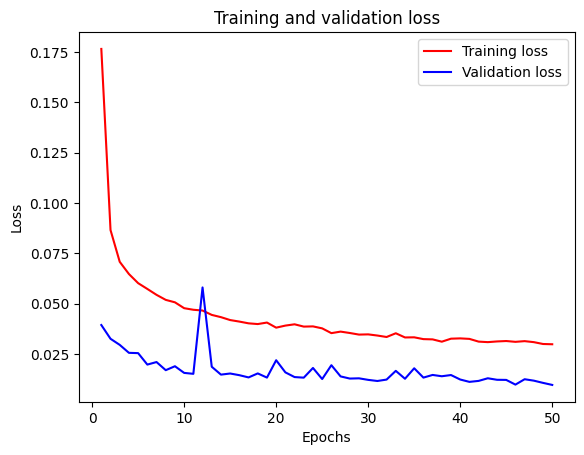

In [133]:
import matplotlib.pyplot as plt
history_dict = history_base.history
loss_values = history_dict['loss']
val_loss_values = history_dict['val_loss']
epochs = range(1, len(loss_values) + 1)
plt.plot(epochs, loss_values, 'r', label='Training loss')
plt.plot(epochs, val_loss_values, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

Graficando accuracy de entrenamiento vs validación

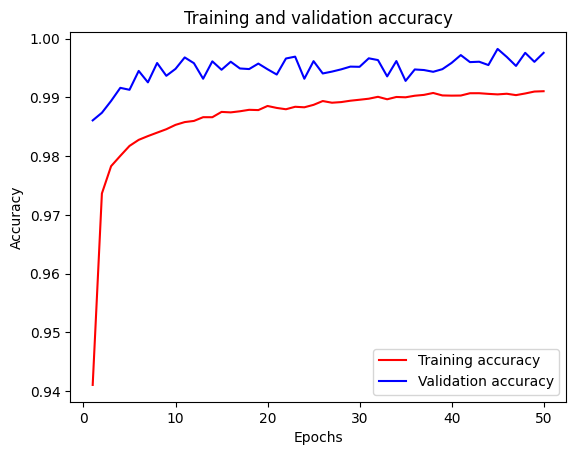

In [135]:
history_dict = history_base.history
accuracy = history_dict['accuracy']
val_accuracy = history_dict['val_accuracy']
epochs = range(1, len(accuracy) + 1)
plt.plot(epochs, accuracy, 'r', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()



### Evaluación del modelo en el conjunto de test

In [138]:
test = modelo.evaluate(x_test, y_test_encoded)

1319/1319 ━━━━━━━━━━━━━━━━━━━━ 1s 787us/step - accuracy: 0.9865 - loss: 0.0335


In [179]:
# Obtener predicciones de probabilidad para cada clase
predicciones_probabilidad = modelo.predict(x_test)

# Obtener la clase predicha para cada punto de datos
predicciones_clase = np.argmax(predicciones_probabilidad, axis=1)


1319/1319 ━━━━━━━━━━━━━━━━━━━━ 1s 898us/step


In [180]:
predicciones_clase

array([0, 0, 0, ..., 0, 0, 0])

In [181]:
from sklearn.metrics import classification_report
print(classification_report(y_test, predicciones_clase))

              precision    recall  f1-score   support

           0       1.00      0.98      0.99     33352
           1       0.92      1.00      0.96      4708
           2       0.97      1.00      0.98      4132

    accuracy                           0.99     42192
   macro avg       0.96      0.99      0.98     42192
weighted avg       0.99      0.99      0.99     42192



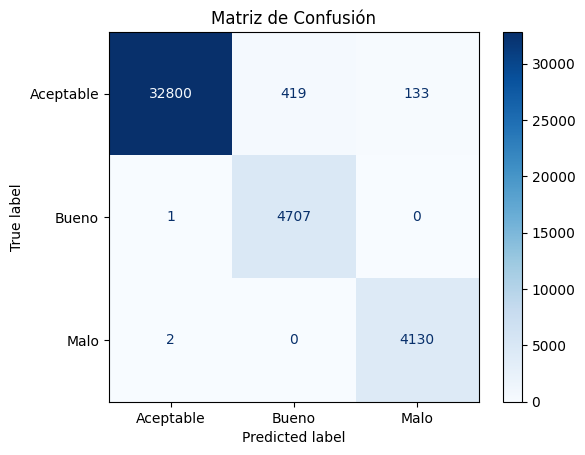

In [182]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

class_names = ['Aceptable', 'Bueno', 'Malo']

# Calcular la matriz de confusión
conf_matrix = confusion_matrix(y_test, predicciones_clase)

# Mostrar la matriz de confusión con las etiquetas de clases
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=class_names)
disp.plot(cmap='Blues', values_format='')
plt.title('Matriz de Confusión')
plt.show()

In [146]:
# Guardar el modelo
modelo.save('modelo_opt.h5')

In [149]:
from tensorflow.keras.models import load_model
# Cargar los pesos del modelo
modelo_final = load_model('modelo_opt.h5')
test = modelo_final.evaluate(x_test, y_test_encoded)

1319/1319 ━━━━━━━━━━━━━━━━━━━━ 1s 823us/step - accuracy: 0.9865 - loss: 0.0335


In [150]:
from joblib import dump, load

# Guardar el preprocesador completo
dump(preprocessor, 'preprocessor.joblib')

['preprocessor.joblib']

### Modelo con undersampling

In [151]:
modelo_under = crear_modelo(input_shape=X_under_train.shape[1], depth=1)

In [153]:
y_under_train_encoded = to_categorical(y_under_train)
y_under_val_encoded = to_categorical(y_under_val)

print('Shape de y_over_train_encoded:', y_under_train_encoded.shape)
print('Shape de y_over_val_encoded:', y_under_val_encoded.shape)

Shape de y_over_train_encoded: (29690, 3)
Shape de y_over_val_encoded: (7423, 3)


In [169]:
history_base_under = modelo_under.fit(X_under_train, y_under_train_encoded, validation_data= (X_under_val, y_under_val_encoded), batch_size=16, epochs = 50)

Epoch 1/50
1856/1856 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9774 - loss: 0.0752 - val_accuracy: 0.9869 - val_loss: 0.0354
Epoch 2/50
1856/1856 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9759 - loss: 0.0739 - val_accuracy: 0.9864 - val_loss: 0.0374
Epoch 3/50
1856/1856 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9772 - loss: 0.0738 - val_accuracy: 0.9830 - val_loss: 0.0405
Epoch 4/50
1856/1856 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9790 - loss: 0.0689 - val_accuracy: 0.9842 - val_loss: 0.0404
Epoch 5/50
1856/1856 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9780 - loss: 0.0693 - val_accuracy: 0.9853 - val_loss: 0.0348
Epoch 6/50
1856/1856 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9772 - loss: 0.0699 - val_accuracy: 0.9873 - val_loss: 0.0323
Epoch 7/50
1856/1856 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 0.9791 - loss: 0.0640 - val_accuracy: 0.9855 - val_loss: 0.0376
Epoch 8/50
1856/1856 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.9780 - loss: 0.0671 - 

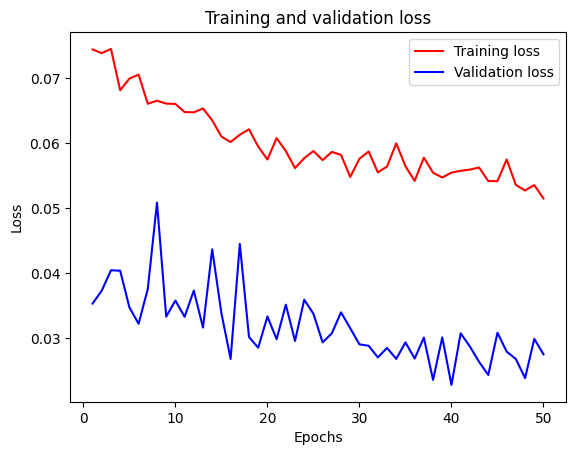

In [170]:
import matplotlib.pyplot as plt
history_dict = history_base_under.history
loss_values = history_dict['loss']
val_loss_values = history_dict['val_loss']
epochs = range(1, len(loss_values) + 1)
plt.plot(epochs, loss_values, 'r', label='Training loss')
plt.plot(epochs, val_loss_values, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

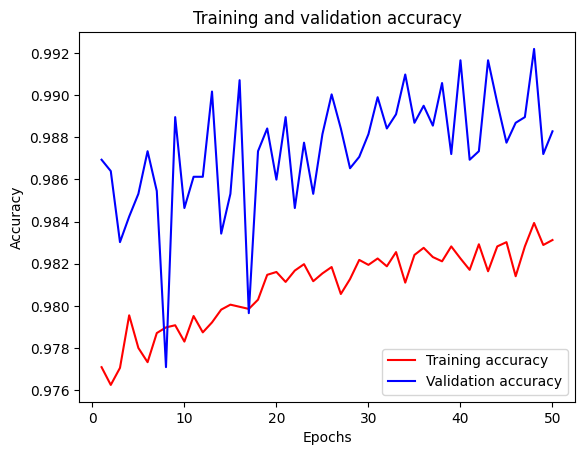

In [171]:
history_dict = history_base_under.history
accuracy = history_dict['accuracy']
val_accuracy = history_dict['val_accuracy']
epochs = range(1, len(accuracy) + 1)
plt.plot(epochs, accuracy, 'r', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

### Evaluación en el conjunto de Test

In [161]:
test = modelo_under.evaluate(x_test, y_test_encoded)

1319/1319 ━━━━━━━━━━━━━━━━━━━━ 1s 807us/step - accuracy: 0.9601 - loss: 0.0723


In [176]:
# Obtener predicciones de probabilidad para cada clase
predicciones_probabilidad = modelo_under.predict(x_test)

# Obtener la clase predicha para cada punto de datos
predicciones_clase_under = np.argmax(predicciones_probabilidad, axis=1)

1319/1319 ━━━━━━━━━━━━━━━━━━━━ 1s 952us/step


In [177]:
print(classification_report(y_test, predicciones_clase_under))

              precision    recall  f1-score   support

           0       1.00      0.96      0.98     33352
           1       0.87      1.00      0.93      4708
           2       0.85      1.00      0.92      4132

    accuracy                           0.97     42192
   macro avg       0.91      0.99      0.94     42192
weighted avg       0.97      0.97      0.97     42192



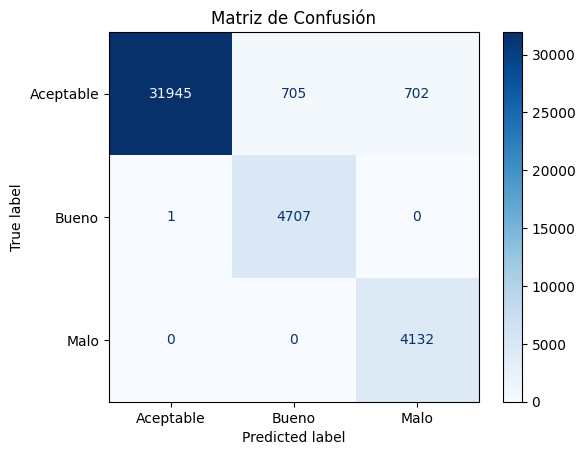

In [178]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

class_names = ['Aceptable', 'Bueno', 'Malo']

# Calcular la matriz de confusión
conf_matrix = confusion_matrix(y_test, predicciones_clase_under)

# Mostrar la matriz de confusión con las etiquetas de clases
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=class_names)
disp.plot(cmap='Blues', values_format='')
plt.title('Matriz de Confusión')
plt.show()

In [189]:
# Guardar el modelo
modelo_under.save('modelo_opt_under.h5')

In [188]:
import pickle
with open('model_over.pkl', 'wb') as model_file:
    pickle.dump(modelo, model_file)

with open('model_under.pkl', 'wb') as model_file:
    pickle.dump(modelo_under, model_file)